In [1]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import math
from sklearn.datasets import make_swiss_roll


print(torch.cuda.is_available())  # TrueならGPUが使える
print(torch.cuda.get_device_name(0))  # GPUの名前を表示

True
NVIDIA GeForce RTX 3060 Ti


## 訓練用データ (Swiss roll)

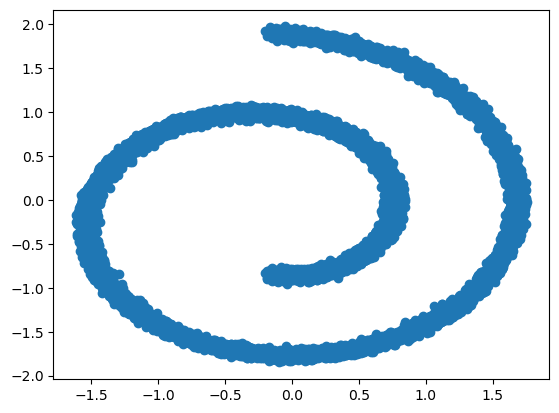

In [2]:
x, _ = make_swiss_roll(n_samples=20000, noise=0.2)
# Make two-dimensional to easen visualization
x = x[:, [0, 2]]

x = (x - x.mean()) / x.std()

plt.scatter(x[:, 0], x[:, 1])

X_data = torch.tensor(x, dtype=torch.float32)

## VE-SDEのノイズスケジュール


$$\beta(t) = \beta_{\mathrm{min}} +(\beta_{\mathrm{max}} -\beta_{\mathrm{min}} ) t $$
$$\int_0^{t}\beta(\xi) d\xi = \beta_{\mathrm{min}} t +\frac{1}{2} (\beta_{\mathrm{max}} -\beta_{\mathrm{min}} ) t^2 $$
$$g(t)=\sqrt{\beta(t)} $$
$$f(t)=-\beta(t) $$
$$r(t)=\frac{1}{\sqrt{\exp{\beta_{\mathrm{min}} t +\frac{1}{2} (\beta_{\mathrm{max}} -\beta_{\mathrm{min}} ) t^2}}} $$
$$\sigma(t)^2 = \frac{1}{r(t)^2}-1$$




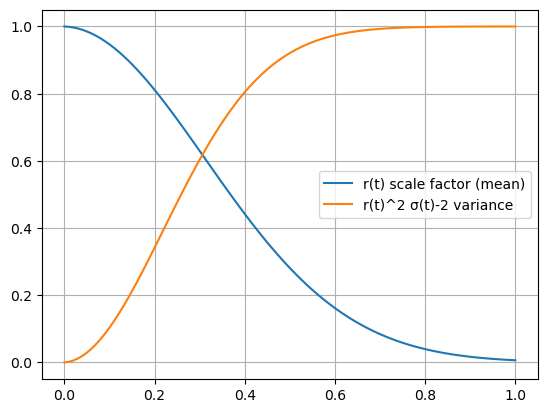

In [194]:
beta_min = 0.1
beta_max = 20

def beta_t(t: torch.Tensor) -> torch.Tensor:
    """
    t: (batch_size, 1)
    """
    # t.shape = (batch_size, 1)
    return beta_min + (beta_max - beta_min) * t  # => (batch_size, 1)

def integral_beta_t(t: torch.Tensor) -> torch.Tensor:
    """
    t: (batch_size, 1)
    """
    # t.shape = (batch_size, 1)
    return beta_min * t + (beta_max - beta_min) * t**2 / 2  # => (batch_size, 1)



def g_t(t: torch.Tensor) -> torch.Tensor:
    """
    dx_t = f_t * x *dt + g_t * dW_t
    t: (batch_size, 1)
    """
    # t.shape = (batch_size, 1)
    return  torch.sqrt(beta_t(t))  # => (batch_size, 1)

def f_t(t: torch.Tensor) -> torch.Tensor:
    """
    dx_t = f_t * x *dt + g_t * dW_t
    t: (batch_size, 1)
    """
    # t.shape = (batch_size, 1)
    return  -0.5 * beta_t(t)

def r_sq_t(t: torch.Tensor) -> torch.Tensor:
    """
    scale scale factor
    t: (batch_size, 1)
    """
    # t.shape = (batch_size, 1)
    return torch.exp(-integral_beta_t(t))  # => (batch_size, 1)

def r_t(t: torch.Tensor) -> torch.Tensor:
    """
    scale scale factor
    t: (batch_size, 1)
    """
    # t.shape = (batch_size, 1)
    return torch.sqrt(r_sq_t(t))  # => (batch_size, 1)


def sigma_sq_t(t: torch.Tensor) -> torch.Tensor:
    """
    ノイズレベルのスケジュール, noise schedule
    t: (batch_size, 1)
    """
    # t.shape = (batch_size, 1)
    return 1/r_sq_t(t) - 1


def sigma_t(t: torch.Tensor) -> torch.Tensor:
    """
    ノイズレベルのスケジュール, noise schedule
    t: (batch_size, 1)
    """
    # t.shape = (batch_size, 1)
    return torch.sqrt(sigma_sq_t(t))  # => (batch_size, 1)

def r_from_sigma(sigma_t: torch.Tensor) -> torch.Tensor:
    """
    ノイズレベルからスケールファクターを計算
    sigma_t: (batch_size, 1)
    """
    # sigma_t.shape = (batch_size, 1)
    return 1/torch.sqrt(1 + sigma_t**2)  # => (batch_size, 1)


t = torch.linspace(0,1,100)


plt.plot(t, r_t(t), label='r(t) scale factor (mean)')
plt.plot(t, (r_t(t)*sigma_t(t))**2, label='r(t)^2 σ(t)-2 variance' )


plt.grid()
plt.legend()



## NNのクラス，スコア関数のクラスを定義

In [215]:
class NNBlock(nn.Module):
    def __init__(self, nunits):
        super(NNBlock, self).__init__()
        self.linear = nn.Linear(nunits, nunits)
        self.activation = nn.Mish()

    def forward(self, x: torch.Tensor):
        # x.shape = (batch_size, nunits)
        x = self.linear(x)
        x = self.activation(x)  # SiLU
        return x



class NNModel(nn.Module):
    def __init__(self, nfeatures: int, nblocks: int = 2, nunits: int = 32):
        super(NNModel, self).__init__()
        #self.bn = nn.BatchNorm1d(nfeatures+1)
        self.inblock = nn.Linear(nfeatures+1, nunits)
        self.midblocks = nn.ModuleList([NNBlock(nunits) for _ in range(nblocks)])
        self.outblock = nn.Linear(nunits, nfeatures)

    def forward(self, x: torch.Tensor, sigma_t: torch.Tensor) -> torch.Tensor:
        val = torch.hstack([x, sigma_t])  # Add sigma_t to inputs
        #val = self.bn(val)
        val = self.inblock(val)
        for midblock in self.midblocks:
            val = midblock(val)
        val = self.outblock(val)
        return val


class ScoreFunction:
    """
    スコア関数
    """

    def __init__(self, model: NNModel):
        """
        model: スコア関数を学習するモデル

        model(x,t) :=   sigma_t * r_t * score_fn(x_t, sigma_t)
        """
        self.model = model

    def __call__(self, x: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        x: 入力データ
        t: 時間
        """
        # x.shape = (batch_size, nfeatures)
        # t.shape = (batch_size, 1)
        sigma_t_val = sigma_t(t)  # Convert t to sigma_t
        r_t_val = r_t(t)  # Convert t to r_t
        return self.model(x, t) / (sigma_t_val * r_t_val)  # => (batch_size, nfeatures)

    def denoiser(self, x: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        return self.model(x, t)


    def x_hat(self, x_t: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        x_tからx_0を推定値の期待値
        x_t: 入力データ
        t: 時間
        """
        r_t_val = r_t(t)  # Convert t to r_t
        sigma_t_val = sigma_t(t)  # Convert t to sigma_t
        x_0 = x_t / r_t_val + sigma_t_val * self.model(x_t, t)
        return x_0


    def train(self):
        """
        学習モードにする
        """
        self.model.train()
    def eval(self):
        """
        評価モードにする
        """
        self.model.eval()






## NNのクラスの初期化

In [216]:
nn_model = NNModel(nfeatures=2, nblocks=3, nunits=64)


device = 'cuda' if torch.cuda.is_available() else 'cpu'
nn_model.to(device)
score_fn = ScoreFunction(nn_model)
print(score_fn.model)
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(score_fn.model.parameters(), lr=1e-3)

NNModel(
  (inblock): Linear(in_features=3, out_features=64, bias=True)
  (midblocks): ModuleList(
    (0-2): 3 x NNBlock(
      (linear): Linear(in_features=64, out_features=64, bias=True)
      (activation): Mish()
    )
  )
  (outblock): Linear(in_features=64, out_features=2, bias=True)
)


## スコアの学習

$$\mathcal{L}(\theta) = \mathbb{E}_{t\sim U[0,T]} \mathbb{E}_{\bm{x}_0\sim p_{data}} \mathbb{E}_{\bm{x}_t\sim p_{\bm{x}_t \mid \bm{x}_0}} || r_t \sigma_t \tilde{\bm{s}}_\theta(\bm{x}_t, t) - r_t \sigma_t \bm{s}(\bm{x}\mid x_0) ||^2 $$
$$ = \mathbb{E}_{t\sim U[0,T]} \mathbb{E}_{\bm{x}_0\sim p_{data}} \mathbb{E}_{\bm{\epsilon} \sim \mathcal{N}(\bm{0}, \bm{I})} || r_t \sigma_t \tilde{\bm{s}}_\theta(\bm{x}_0 + \sigma_t \bm{\epsilon} , t) +\bm{\epsilon}||^2$$

In [217]:
epochs = 1000
batch_size = 2000
score_fn.train()
nn_model.to(device)

for epoch in range(epochs):

    epoch_loss = 0
    step = 0

    for i in range(0, len(X_data)// batch_size):
        Xbatch = X_data[i:i + batch_size]

        t = torch.rand(batch_size, 1)  # 0~1のランダムなtを生成
        sigma_t_batch = sigma_t(t)
        r_t_batch = r_t(t)
        eps = torch.randn_like(Xbatch)  # ノイズを生成
        x_t = r_t_batch * Xbatch + eps * sigma_t_batch * r_t_batch  # ノイズを加える


        denoiser = score_fn.denoiser(x_t.to(device), t.to(device))

        loss = loss_fn(denoiser, -eps.to(device))
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        step += 1

    epoch_loss /= step  # 平均損失を計算

    if epoch == 0 or (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{epochs}], Loss: {epoch_loss:.4f}')


Epoch [1/1000], Loss: 0.8884
Epoch [100/1000], Loss: 0.2541
Epoch [200/1000], Loss: 0.2424
Epoch [300/1000], Loss: 0.2340
Epoch [400/1000], Loss: 0.2319
Epoch [500/1000], Loss: 0.2270
Epoch [600/1000], Loss: 0.2251
Epoch [700/1000], Loss: 0.2268
Epoch [800/1000], Loss: 0.2302
Epoch [900/1000], Loss: 0.2281
Epoch [1000/1000], Loss: 0.2284


## 逆拡散過程によるサンプリング

オイラー・丸山法

$$ \bm{x}_{t-\Delta t} = \bm{x}_t - \left[  -f(t)\bm{x}_t - g(t)^2 \tilde{\bm{s}}_{\theta^*}(\bm{x}_t, t)  \right]\Delta t+ g(t)\sqrt{\Delta t} \bm{z} $$

$$\bm{z}\sim \mathcal{N}(\bm{0},\bm{I})$$

In [218]:
def reverse_SDE_sampling(score_fn: ScoreFunction, n_samples: int = 100,n_steps: int = 100, start_time=1):
    """
    スコア関数を用いてサンプリングする
    """
    # 初期化
    sigma_max = 1
    x_t = torch.randn(n_samples, 2) * sigma_max  # 初期状態は大きなノイズ
    timesteps = torch.linspace(start_time, 0, n_steps+1)  # タイムステップを生成

    x_trace = []

    score_fn.model.to('cpu')


    with torch.no_grad():
        score_fn.eval()
        for i in range(n_steps ):

            t = timesteps[i]


            # t を [nsample,1 ] にする。
            t = t.unsqueeze(0).repeat(n_samples, 1)

            dt = abs(timesteps[i] - timesteps[i + 1] )

            sigma_ti = sigma_t(t)
            r_t_val = r_t(t)

            x_t = x_t + x_t*f_t(t) * -dt - g_t(t)**2 * score_fn(x_t, t) * -dt + g_t(t) * torch.randn_like(x_t) * math.sqrt(dt)

            x_trace.append(x_t.detach().numpy())

    x_0 = x_trace[-1]  # 最後のステップの結果を取得

    return x_0, x_trace


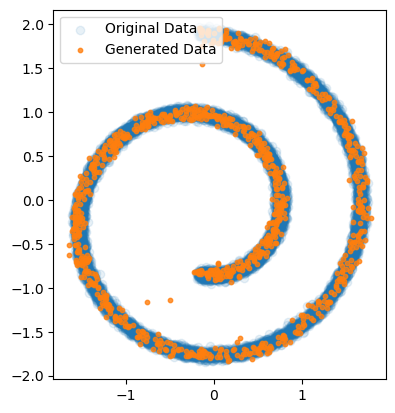

In [219]:

x_0, x_trace = reverse_SDE_sampling(score_fn, n_samples=1000, n_steps=100,start_time=0.5)



plt.scatter(X_data[:, 0], X_data[:, 1], alpha=0.1, label='Original Data')

plt.scatter(x_0[:, 0], x_0[:, 1], alpha=0.8,s=10, label='Generated Data')

plt.gca().set_aspect('equal', adjustable='box')
plt.legend()

In [220]:

!pip -q install plotly

import numpy as np
import plotly.graph_objects as go

def visualize_trace_plotly(x_trace):
    arr = np.stack(x_trace, axis=0)  # (T, N, 2)
    T = arr.shape[0]

    fig = go.Figure(
        data=[go.Scatter(x=arr[0,:,0], y=arr[0,:,1], mode='markers')],
        layout=go.Layout(
            xaxis=dict(scaleanchor='y', scaleratio=1),  # 正方比
            title=f"t-step: 0 / {T-1}",
            updatemenus=[dict(
                type="buttons",
                buttons=[
                    dict(label="Play", method="animate",
                         args=[None, {"frame": {"duration": 60, "redraw": True},
                                      "fromcurrent": True, "transition": {"duration": 0}}]),
                    dict(label="Pause", method="animate",
                         args=[[None], {"frame": {"duration": 0, "redraw": False},
                                        "mode": "immediate",
                                        "transition": {"duration": 0}}]),
                ]
            )]
        ),
        frames=[
            go.Frame(
                data=[go.Scatter(x=arr[k,:,0], y=arr[k,:,1], mode='markers')],
                name=str(k),
                layout=go.Layout(title=f"t-step: {k} / {T-1}")
            ) for k in range(T)
        ]
    )

    # スライダー
    fig.update_layout(
        sliders=[{
            "steps": [
                {"method": "animate", "args": [[str(k)],
                 {"mode": "immediate", "frame": {"duration": 0, "redraw": True},
                  "transition": {"duration": 0}}], "label": str(k)}
                for k in range(T)
            ],
            "active": 0
        }]
    )

    fig.show()

# ---- 使い方例 ----
# x_0, x_trace = sampling(score_fn, n_samples=100, n_steps=100)
# visualize_trace_plotly(x_trace)

In [221]:
visualize_trace_plotly(x_trace)


# 観測ガイダンス付き拡散モデル

$$ \bm{x}_{t-\Delta t} = \bm{x}_t - \left[  -f(t)\bm{x}_t - g(t)^2 (\tilde{\bm{s}}_{\theta^*}(\bm{x}_t, t)  + \nabla_{\bm{x}_t} \log{p(y\mid \bm{x}_t)}) \right]\Delta t+ g(t)\sqrt{\Delta t} \bm{z} $$

$$\bm{z}\sim \mathcal{N}(\bm{0},\bm{I})$$

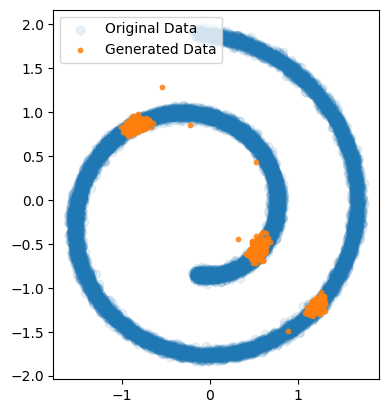

In [222]:

def likelihood_guidance(score_fn: ScoreFunction, x_t, t):

    """    
    logp(y|x_t)の計算と勾配を求める
    x_t: 入力データ (N, D)
    t: 時間 (N, 1)
    """

    y = 0
    y = y*torch.ones((x_t.shape[0],1), dtype=torch.float32)  # 目標値を設定
    sigma_y = 0.1  # yのノイズレベルは0.02
    sigma_t_val = sigma_t(t)  # tをsigma_tに変換

    def forward(x_0):
        return (x_0[:,0] + x_0[:,1]).unsqueeze(1)  # yの形状に合わせるためにunsqueezeする


    x_t = x_t.detach().requires_grad_(True)
    x_hat = score_fn.x_hat(x_t, t)  # 逆拡散過程の計算
    resid = y - forward(x_hat)                   # (N, D)
    S = (sigma_y**2 + sigma_t_val**2)       # (N,1) か (1,)
    loglikelihood = -0.5 * (resid**2).sum(dim=1) / S.squeeze()   # (N,)

    # ベクトル出力なので，合計にしてスカラー化してから勾配を取る
    x_grad = torch.autograd.grad(
        outputs=loglikelihood.sum(),    # スカラー
        inputs=x_t,
        retain_graph=False,             # ループ内なのでできるだけFalse
        create_graph=False,             # 2階微分が不要ならFalse
    )[0]



    return loglikelihood.detach(), x_grad.detach()


def reverse_SDE_sampling_with_guidance(score_fn: ScoreFunction, n_samples: int = 100,n_steps: int = 100,start_time=1):
    """
    スコア関数を用いてサンプリングする
    """
    # 初期化
    sigma_max = 1
    x_t = torch.randn(n_samples, 2) * sigma_max  # 初期状態は大きなノイズ
    timesteps = torch.linspace(start_time, 0, n_steps+1)  # タイムステップを生成

    x_trace = []


    for i in range(n_steps ):

        t = timesteps[i]


        # t を [nsample,1 ] にする。
        t = t.unsqueeze(0).repeat(n_samples, 1)
        dt = abs(timesteps[i] - timesteps[i + 1] )
        _, x_grad = likelihood_guidance(score_fn, x_t, t)


        x_t = x_t + x_t*f_t(t) * -dt - g_t(t)**2 * (score_fn(x_t, t)+1*x_grad )   * -dt + g_t(t) * torch.randn_like(x_t) * math.sqrt(dt)

        x_trace.append(x_t.detach().numpy())

    x_0 = x_trace[-1]  # 最後のステップの結果を取得

    return x_0, x_trace

x_0, x_trace = reverse_SDE_sampling_with_guidance(score_fn, n_samples=1000, n_steps=200,start_time=0.5)



plt.scatter(X_data[:, 0], X_data[:, 1], alpha=0.1, label='Original Data')

plt.scatter(x_0[:, 0], x_0[:, 1], alpha=0.8,s=10, label='Generated Data')

plt.gca().set_aspect('equal', adjustable='box')
plt.legend()

In [223]:

visualize_trace_plotly(x_trace)